<a href="https://colab.research.google.com/github/NoofAlsafi-DS/NLP_Project/blob/main/Copy_of_NLP_Sentiment_Analysis_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___

# WELCOME!

Welcome to the "***Sentiment Analysis and Classification Project***" project, the first and only project of the ***Natural Language Processing (NLP)*** course.

This analysis will focus on using Natural Language techniques to find broad trends in the written thoughts of the customers.
The goal in this project is to predict whether customers recommend the product they purchased using the information in their review text.

One of the challenges in this project is to extract useful information from the *Review Text* variable using text mining techniques. The other challenge is that you need to convert text files into numeric feature vectors to run machine learning algorithms.

At the end of this project, you will learn how to build sentiment classification models using Machine Learning algorithms (***Logistic Regression, Naive Bayes, Support Vector Machine, Random Forest*** and ***Ada Boosting***), **Deep Learning algorithms** and **BERT algorithm**.

Before diving into the project, please take a look at the Determines and Tasks.

- ***NOTE:*** *This tutorial assumes that you already know the basics of coding in Python and are familiar with the theory behind the algorithms mentioned above as well as NLP techniques.*



---
---


# #Determines
The data is a collection of 22641 Rows and 10 column variables. Each row includes a written comment as well as additional customer information.
Also each row corresponds to a customer review, and includes the variables:


**Feature Information:**

**Clothing ID:** Integer Categorical variable that refers to the specific piece being reviewed.

**Age:** Positive Integer variable of the reviewers age.

**Title:** String variable for the title of the review.

**Review Text:** String variable for the review body.

**Rating:** Positive Ordinal Integer variable for the product score granted by the customer from 1 Worst, to 5 Best.

**Recommended IND:** Binary variable stating where the customer recommends the product where 1 is recommended, 0 is not recommended.

**Positive Feedback Count:** Positive Integer documenting the number of other customers who found this review positive.

**Division Name:** Categorical name of the product high level division.

**Department Name:** Categorical name of the product department name.

**Class Name:** Categorical name of the product class name.

---

The basic goal in this project is to predict whether customers recommend the product they purchased using the information in their *Review Text*.
Especially, it should be noted that the expectation in this project is to use only the "Review Text" variable and neglect the other ones.
Of course, if you want, you can work on other variables individually.

Project Structure is separated in five tasks: ***EDA, Feature Selection and Data Cleaning , Text Mining, Word Cloud*** and ***Sentiment Classification with Machine Learning, Deep Learning and BERT model***.

Classically, you can start to know the data after doing the import and load operations.
You need to do missing value detection for Review Text, which is the only variable you need to care about. You can drop other variables.

You will need to apply ***noise removal*** and ***lexicon normalization*** processes by using the capabilities of the ***nltk*** library to the data set that is ready for text mining.

Afterwards, you will implement ***Word Cloud*** as a visual analysis of word repetition.

Finally, You will build models with five different algorithms and compare their performance. Thus, you will determine the algorithm that makes the most accurate emotion estimation by using the information obtained from the * Review Text * variable.






---
---


# #Tasks

#### 1. Exploratory Data Analysis

- Import Modules, Load Discover the Data

#### 2. Feature Selection and Data Cleaning

- Feature Selection and Rename Column Name
- Missing Value Detection

#### 3. Text Mining

- Tokenization
- Noise Removal
- Lexicon Normalization

#### 4. WordCloud - Repetition of Words

- Detect Reviews
- Collect Words
- Create Word Cloud


#### 5. Sentiment Classification with Machine Learning, Deep Learning and BERT Model

- Train - Test Split
- Vectorization
- TF-IDF
- Logistic Regression
- Naive Bayes
- Support Vector Machine
- Random Forest
- AdaBoost
- Deep Learning Model
- BERT Model
- Model Comparison

---
---


# Sentiment analysis of women's clothes reviews


In this project we used sentiment analysis to determined whether the product is recommended or not. We used different machine learning algorithms to get more accurate predictions. The following classification algorithms have been used: ML algorithms(Logistic Regression, Naive Bayes, Support Vector Machine (SVM), Random Forest and Ada Boosting), Deep learning algorithm and BERT algorithm. The dataset comes from Woman Clothing Review that can be find at (https://www.kaggle.com/nicapotato/womens-ecommerce-clothing-reviews.


## 1. Exploratory Data Analysis

### Import Libraries, Load and Discover the Data

In [1]:
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns
import missingno as msno
import scipy.stats as stats
#from matplotlib_dashboard import MatplotlibDashboard

import re
import random
import string
import requests
import tempfile

from PIL import Image
from tqdm.notebook import tqdm
from wordcloud import WordCloud

import warnings
warnings.filterwarnings("ignore", category=FutureWarning, module="sklearn")

# memory management and garbage collection
import gc
gc.collect()

import nltk
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
import warnings
warnings.filterwarnings("ignore")
plt.rcParams["figure.figsize"] = (7,4)
pd.set_option('display.max_columns', 50)

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
df =pd.read_csv("drive/My Drive/WomensClothing-E-Commerce-Reviews.csv")
df.head()

,Unnamed: 0,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,0,767,33,NaN,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates
1,1,1080,34,NaN,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses
2,2,1077,60,Some major design flaws,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
3,3,1049,50,My favorite buy!,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants
4,4,847,47,Flattering shirt,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses


In [4]:
df_copy = df.copy()
print('Shape of DataFrame: ',df_copy.shape,'\n')

Shape of DataFrame:  (23486, 11) 



### Data Wrangling

In [5]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23486 entries, 0 to 23485
Data columns (total 11 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   Unnamed: 0               23486 non-null  int64 
 1   Clothing ID              23486 non-null  int64 
 2   Age                      23486 non-null  int64 
 3   Title                    19676 non-null  object
 4   Review Text              22641 non-null  object
 5   Rating                   23486 non-null  int64 
 6   Recommended IND          23486 non-null  int64 
 7   Positive Feedback Count  23486 non-null  int64 
 8   Division Name            23472 non-null  object
 9   Department Name          23472 non-null  object
 10  Class Name               23472 non-null  object
dtypes: int64(6), object(5)
memory usage: 2.0+ MB


In [6]:
df_copy.isna().sum()

Unnamed: 0                    0
Clothing ID                   0
Age                           0
Title                      3810
Review Text                 845
Rating                        0
Recommended IND               0
Positive Feedback Count       0
Division Name                14
Department Name              14
Class Name                   14
dtype: int64

In [7]:
df_copy.drop(['Clothing ID'], axis=1, inplace=True)
df_copy.dropna(subset=['Review Text','Division Name',], inplace=True)

In [8]:
df_copy = df_copy[~((df_copy["Rating"] == 1) & (df_copy["Recommended IND"] == 1))]
df_copy =df_copy[~((df_copy["Rating"] == 2) & (df_copy["Recommended IND"] == 1))]
df_copy = df_copy[~((df_copy["Rating"] == 3) & (df_copy["Recommended IND"] == 1))]
df_copy = df_copy[~((df_copy["Rating"] == 4) & (df_copy["Recommended IND"] == 0))]
df_copy = df_copy[~((df_copy["Rating"] == 5) & (df_copy["Recommended IND"] == 0))]

In [9]:
df_copy["Recommended"]=df_copy["Recommended IND"]

##EDA

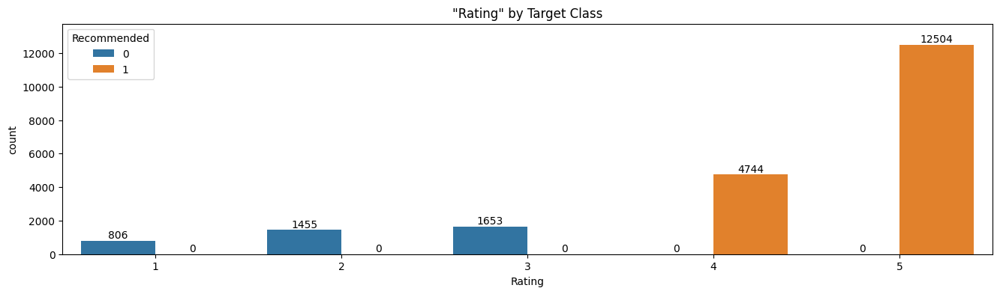

In [10]:
plt.figure(figsize=(16, 4))
ax = sns.countplot(data = df_copy, x ="Rating", hue = "Recommended",
                   order = df_copy['Rating'].value_counts().sort_values().index)
plt.title('"Rating" by Target Class');
plt.margins(y=.1)
for c in ax.containers:
    ax.bar_label(c)

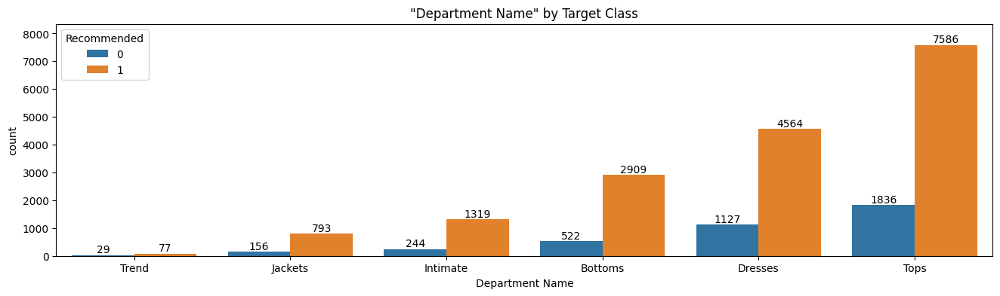

In [11]:
plt.figure(figsize=(16, 4))
ax = sns.countplot(data =df_copy, x = "Department Name", hue = "Recommended",
                   order = df_copy['Department Name'].value_counts().sort_values().index)
plt.title('"Department Name" by Target Class');
plt.margins(y=.1)
for p in ax.containers:
    ax.bar_label(p)

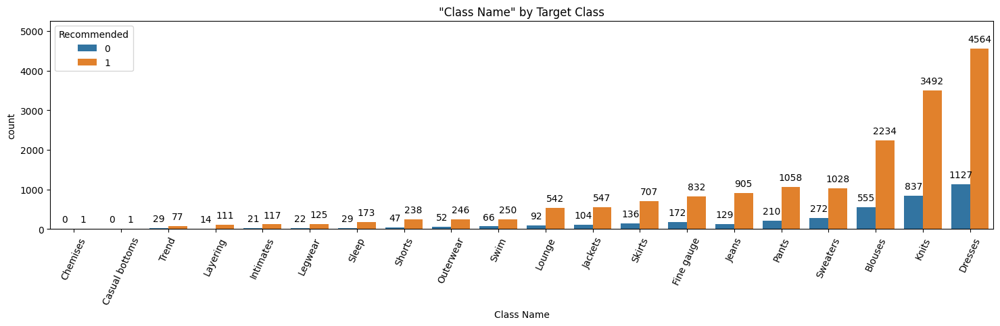

In [12]:
plt.figure(figsize=(18, 4))
ax = sns.countplot(data =df_copy, x = "Class Name", hue = "Recommended",
                   order = df_copy['Class Name'].value_counts().sort_values().index)
plt.title('"Class Name" by Target Class');
plt.xticks(rotation = 65);
plt.margins(y=.15)
for p in ax.containers:
    ax.bar_label(p, rotation=0, padding=5)

In [13]:
df_copy['Text']  = df_copy['Title'].fillna('-') + ' ' + df['Review Text']
df_copy.drop(['Title', 'Review Text', 'Division Name'],axis=1,inplace=True)

In [14]:
df_copy['Text_Length'] = df_copy['Text'].astype('str').apply(len)
df_copy = df_copy.reset_index(drop=True)

#### Check Proportion of Target Class Variable:

The target class variable is imbalanced, where "Recommended" values are more dominating then "Not Recommendation".

In [15]:
df_copy["Recommended"].value_counts(normalize=True)

1    0.815046
0    0.184954
Name: Recommended, dtype: float64

## 2. Feature Selection and Data Cleaning

From now on, the DataFrame you will work with should contain two columns: **"Review Text"** and **"Recommended IND"**. You can do the missing value detection operations from now on. You can also rename the column names if you want.



### Feature Selection and Rename Column Name

In [16]:
df_copy = pd.DataFrame(df_copy[["Text", "Recommended"]])
df_copy

,Text,Recommended
0,- Absolutely wonderful - silky and sexy and co...,1
1,- Love this dress! it's sooo pretty. i happe...,1
2,Some major design flaws I had such high hopes ...,0
3,"My favorite buy! I love, love, love this jumps...",1
4,Flattering shirt This shirt is very flattering...,1
...,...,...
21157,Unflattering I was surprised at the positive r...,0
21158,What a fun piece! So i wasn't sure about order...,1
21159,Great dress for many occasions I was very happ...,1
21160,"Cute, but see through This fit well, but the t...",0


---
---


### Missing Value Detection

In [17]:
df_copy.isna().sum()

Text           0
Recommended    0
dtype: int64

---
---


## 3. Text Mining

Text is the most unstructured form of all the available data, therefore various types of noise are present in it. This means that the data is not readily analyzable without any pre-processing. The entire process of cleaning and standardization of text, making it noise-free and ready for analysis is known as **text preprocessing**.

The three key steps of text preprocessing:

- **Tokenization:**
This step is one of the top priorities when it comes to working on text mining. Tokenization is essentially splitting a phrase, sentence, paragraph, or an entire text document into smaller units, such as individual words or terms. Each of these smaller units are called tokens.

- **Noise Removal:**
Any piece of text which is not relevant to the context of the data and the end-output can be specified as the noise.
For example – language stopwords (commonly used words of a language – is, am, the, of, in etc), URLs or links, upper and lower case differentiation, punctuations and industry specific words. This step deals with removal of all types of noisy entities present in the text.


- **Lexicon Normalization:**
Another type of textual noise is about the multiple representations exhibited by single word.
For example – “play”, “player”, “played”, “plays” and “playing” are the different variations of the word – “play”. Though they mean different things, contextually they all are similar. This step converts all the disparities of a word into their normalized form (also known as lemma).
There are two methods of lexicon normalisation; **[Stemming or Lemmatization](https://www.guru99.com/stemming-lemmatization-python-nltk.html)**. Lemmatization is recommended for this case, because Lemmatization as this will return the root form of each word (rather than just stripping suffixes, which is stemming).

As the first step change text to tokens and convertion all of the words to lower case.  Next remove punctuation, bad characters, numbers and stop words. The second step is aimed to normalization them throught the Lemmatization method.


***Note:*** *Use the functions of the ***[nltk Library](https://www.guru99.com/nltk-tutorial.html)*** for all the above operations.*



### Tokenization, Noise Removal, Lexicon Normalization

In [18]:
import nltk
from nltk.tokenize import WordPunctTokenizer
from nltk.corpus import stopwords
import gzip
import json
nltk.download('stopwords')
nltk.download('wordnet', download_dir='/usr/share/nltk_data')
nltk.download('averaged_perceptron_tagger')

nltk.download('punkt')

# if 'wordnet' error
!unzip -oq /usr/share/nltk_data/corpora/wordnet.zip -d /usr/share/nltk_data/corpora

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /usr/share/nltk_data...
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [19]:
stop_words = set(stopwords.words('english'))

words_to_exclude = {"no", "not"}

stop_words.difference_update(words_to_exclude)

In [20]:
def preprocess_cleaning(data):

    import re

    #1. Removing URLS
    data = re.sub('http\S*', '', data).strip()
    data = re.sub('www\S*', '', data).strip()

    #2. Removing Tags
    data = re.sub('#\S*', '', data).strip()

    #3. Removing Mentions
    data = re.sub('@\S*', '', data).strip()

    #4. Removing upper brackets to keep negative auxiliary verbs in text
    data = data.replace("'", "")

    #5. Tokenize
    text_tokens = word_tokenize(data.lower())

    #6. Remove Puncs and numbers
    tokens_without_punc = [w for w in text_tokens if w.isalpha()]

    #7. Removing Stopwords
    tokens_without_sw = [t for t in tokens_without_punc if t not in stop_words]

    #8. lemma
    text_cleaned = [WordNetLemmatizer().lemmatize(t) for t in tokens_without_sw]


    #9. joining
    return " ".join(text_cleaned)

In [21]:
df_copy['text_clean']= df_copy['Text'].apply(preprocess_cleaning)
df_copy

,Text,Recommended,text_clean
0,- Absolutely wonderful - silky and sexy and co...,1,absolutely wonderful silky sexy comfortable
1,- Love this dress! it's sooo pretty. i happe...,1,love dress sooo pretty happened find store im ...
2,Some major design flaws I had such high hopes ...,0,major design flaw high hope dress really wante...
3,"My favorite buy! I love, love, love this jumps...",1,favorite buy love love love jumpsuit fun flirt...
4,Flattering shirt This shirt is very flattering...,1,flattering shirt shirt flattering due adjustab...
...,...,...,...
21157,Unflattering I was surprised at the positive r...,0,unflattering surprised positive review product...
21158,What a fun piece! So i wasn't sure about order...,1,fun piece wasnt sure ordering skirt couldnt se...
21159,Great dress for many occasions I was very happ...,1,great dress many occasion happy snag dress gre...
21160,"Cute, but see through This fit well, but the t...",0,cute see fit well top see never would worked i...


## 4. WordCloud - Repetition of Words

Now you'll create a Word Clouds for reviews, representing most common words in each target class.

Word Cloud is a data visualization technique used for representing text data in which the size of each word indicates its frequency or importance. Significant textual data points can be highlighted using a word cloud.

You are expected to create separate word clouds for positive and negative reviews. You can qualify a review as positive or negative, by looking at its recommended status. You may need to use capabilities of matplotlib for visualizations.

You can follow the steps below:

- Detect Reviews
- Collect Words
- Create Word Cloud


### Detect Reviews (positive and negative separately)

In [22]:
import collections
df_copy['text_list'] = df_copy['text_clean'].apply(lambda x:str(x).split())
top = collections.Counter([item for sublist in df_copy['text_list'] for item in sublist])
temp = pd.DataFrame(top.most_common(50))
temp.columns = ['Common_words','count']
temp.style.background_gradient(cmap='Blues')

,Common_words,count
0,dress,12099
1,love,10443
2,fit,10091
3,not,9915
4,size,8871
5,top,8794
6,great,7597
7,color,6909
8,like,6640
9,look,6596


In [23]:
Positive_sent= df_copy[df_copy['Recommended']==1]["text_clean"]
Negative_sent= df_copy[df_copy['Recommended']==0]["text_clean"]

In [24]:
Positive_sent

0              absolutely wonderful silky sexy comfortable
1        love dress sooo pretty happened find store im ...
3        favorite buy love love love jumpsuit fun flirt...
4        flattering shirt shirt flattering due adjustab...
6        cagrcoal shimmer fun aded basket hte last mint...
                               ...                        
21155    cheeky bottom cute defiantly cheeky would reco...
21156    entrancing im impressed beautiful color combin...
21158    fun piece wasnt sure ordering skirt couldnt se...
21159    great dress many occasion happy snag dress gre...
21161    please make like one dress lovely platinum fem...
Name: text_clean, Length: 17248, dtype: object

In [25]:
Negative_sent

2        major design flaw high hope dress really wante...
5        not petite love tracy reese dress one not peti...
10       dress look like made cheap material dress run ...
20       not look like first not pullover styling side ...
22       fall flat loved material didnt really look lon...
                               ...                        
21132    not tried color really pretty fun donset want ...
21133    wanted love jacket soft great color unfortunat...
21142    high hope purchased good price typically love ...
21157    unflattering surprised positive review product...
21160    cute see fit well top see never would worked i...
Name: text_clean, Length: 3914, dtype: object

### Collect Words (positive and negative separately)

In [26]:
word_cloud_positive= ' '.join(Positive_sent)
word_cloud_positive

'absolutely wonderful silky sexy comfortable love dress sooo pretty happened find store im glad bc never would ordered online bc petite bought petite love length hit little knee would definitely true midi someone truly petite favorite buy love love love jumpsuit fun flirty fabulous every time wear get nothing great compliment flattering shirt shirt flattering due adjustable front tie perfect length wear legging sleeveless pair well cardigan love shirt cagrcoal shimmer fun aded basket hte last mintue see would look like person store pick went teh darkler color pale hte color really gorgeous turn mathced everythiing trying prefectly little baggy hte x hte msallet size bummer no petite decided jkeep though said matvehd everything ejans pant skirt waas trying kept oops shimmer surprisingly go lot ordered carbon store pick ton stuff always try used top pair skirt pant everything went color really nice charcoal shimmer went well pencil skirt flare pant etc compaint bit big sleeve long doesnt

In [27]:
word_cloud_negative= ' '.join(Negative_sent)
word_cloud_negative

'major design flaw high hope dress really wanted work initially ordered petite small usual size found outrageously small small fact could not zip reordered petite medium overall top half comfortable fit nicely bottom half tight layer several somewhat cheap net layer imo major design flaw net layer sewn directly zipper c not petite love tracy reese dress one not petite foot tall usually wear brand dress pretty package lot dress skirt long full overwhelmed small frame not stranger alteration shortening narrowing skirt would take away embellishment garment love color idea style not work returned dress dress look like made cheap material dress run small esp zipper area run ordered sp typically fit tight material top look feel cheap even pulling cause rip fabric pretty disappointed going christmas dress year needle say going back not look like first not pullover styling side zipper wouldnt purchased knew side zipper large bust side zipper next impossible second tulle feel look cheap slip aw

### Create Word Cloud (for most common words in recommended not recommended reviews separately)

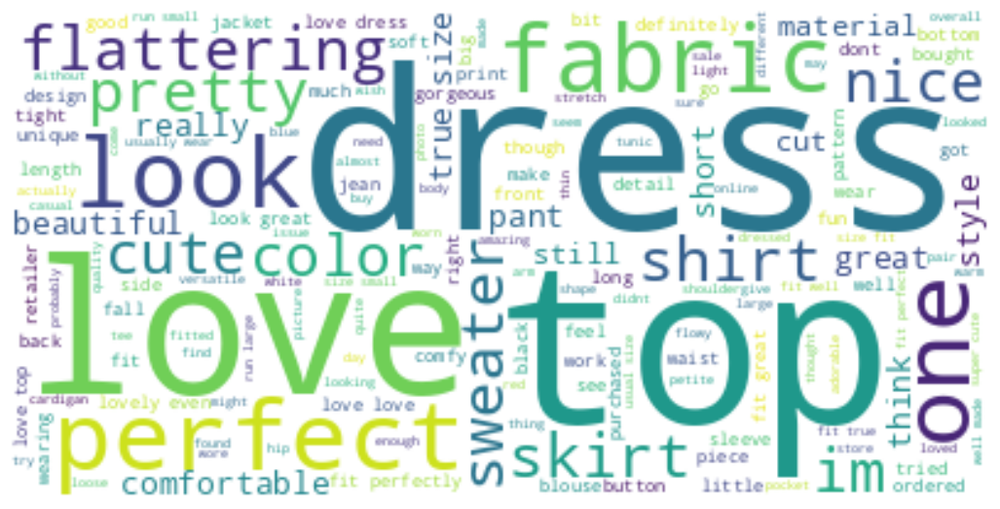

In [28]:
from wordcloud import WordCloud
worldcloud_p= WordCloud(background_color="white", max_words =250)
worldcloud_p.generate(word_cloud_positive)
import matplotlib.pyplot as plt # The matplotlib library is used for visualization purposes
plt.figure(figsize = (13,13))
plt.imshow(worldcloud_p, interpolation="bilinear")
plt.axis("off")
plt.show()

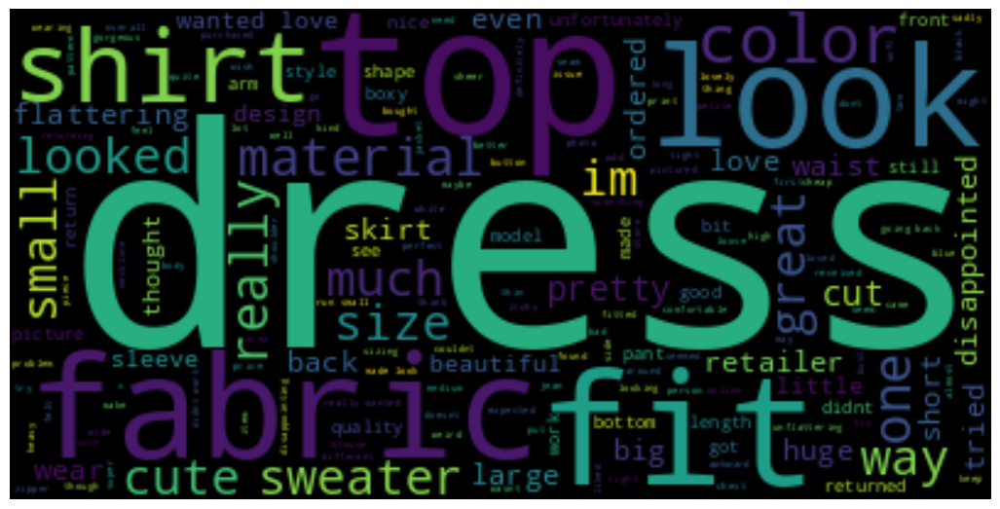

In [29]:
from wordcloud import WordCloud
worldcloud_p= WordCloud(background_color="black", max_words =250)
worldcloud_p.generate(word_cloud_negative)
import matplotlib.pyplot as plt # The matplotlib library is used for visualization purposes
plt.figure(figsize = (13,13))
plt.imshow(worldcloud_p, interpolation="bilinear")
plt.axis("off")
plt.show()

In [30]:
df_copy["Text"]=df_copy["text_clean"]
df_copy = pd.DataFrame(df_copy[["Text", "Recommended"]])
df_copy

,Text,Recommended
0,absolutely wonderful silky sexy comfortable,1
1,love dress sooo pretty happened find store im ...,1
2,major design flaw high hope dress really wante...,0
3,favorite buy love love love jumpsuit fun flirt...,1
4,flattering shirt shirt flattering due adjustab...,1
...,...,...
21157,unflattering surprised positive review product...,0
21158,fun piece wasnt sure ordering skirt couldnt se...,1
21159,great dress many occasion happy snag dress gre...,1
21160,cute see fit well top see never would worked i...,0


In [31]:
df_copy

,Text,Recommended
0,absolutely wonderful silky sexy comfortable,1
1,love dress sooo pretty happened find store im ...,1
2,major design flaw high hope dress really wante...,0
3,favorite buy love love love jumpsuit fun flirt...,1
4,flattering shirt shirt flattering due adjustab...,1
...,...,...
21157,unflattering surprised positive review product...,0
21158,fun piece wasnt sure ordering skirt couldnt se...,1
21159,great dress many occasion happy snag dress gre...,1
21160,cute see fit well top see never would worked i...,0


## 5. Sentiment Classification with Machine Learning, Deep Learning and BERT model

Before moving on to modeling, as data preprocessing steps you will need to perform **[vectorization](https://machinelearningmastery.com/prepare-text-data-machine-learning-scikit-learn/)** and **train-test split**. You have performed many times train test split process before.
But you will perform the vectorization for the first time.

Machine learning algorithms most often take numeric feature vectors as input. Thus, when working with text documents, you need a way to convert each document into a numeric vector. This process is known as text vectorization. Commonly used vectorization approach that you will use here is to represent each text as a vector of word counts.

At this moment, you have your review text column as a token (which has no punctuations and stopwords). You can use Scikit-learn’s CountVectorizer to convert the text collection into a matrix of token counts. You can imagine this resulting matrix as a 2-D matrix, where each row is a unique word, and each column is a review.

Train all models using TFIDF and Count vectorizer data.

**For Deep learning model, use embedding layer for all words.**

**For BERT model, use TF tensor**

After performing data preprocessing, build your models using following classification algorithms:

- Logistic Regression,
- Naive Bayes,
- Support Vector Machine,
- Random Forest,
- Ada Boosting
- Deep Learning Model
- BERT Model

### Train - Test Split

To run machine learning algorithms we need to convert text files into numerical feature vectors. We will use bag of words model for our analysis.

First we spliting the data into train and test sets:

In [32]:
from sklearn.model_selection import train_test_split
X = df_copy["Text"].values
y = df_copy["Recommended"].map({0:1, 1:0}).values

In [33]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.1,stratify=y,random_state=101)

In the next step we create a numerical feature vector for each document:

### Count Vectorization

In [34]:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(preprocessor=preprocess_cleaning,
                             min_df=3,
                             max_df=0.90)
X_train_count = vectorizer.fit_transform(X_train)
X_test_count = vectorizer.transform(X_test)
X_train_count.toarray()

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [35]:
pd.DataFrame(X_train_count.toarray(), columns = vectorizer.get_feature_names_out())

,aa,ab,abdomen,ability,able,abo,abroad,absolute,absolutely,absolutley,abstract,absurd,abt,abundance,ac,accent,accented,accentuate,accentuated,accentuates,accentuating,accept,acceptable,access,accessorize,...,yikes,yo,yoga,yogi,yoke,york,youd,youll,young,younger,youre,youthful,youve,yr,yuck,yucky,yummy,zero,zip,zipped,zipper,zippered,zipping,zone,zoom
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19040,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
19041,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
19042,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
19043,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### TF-IDF

In [36]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf_vectorizer = TfidfVectorizer(preprocessor=preprocess_cleaning, min_df=3, max_df=0.90)
X_train_tfidf = tfidf_vectorizer.fit_transform(X_train)
X_test_tfidf = tfidf_vectorizer.transform(X_test)

In [37]:
X_train_tfidf.toarray()

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [38]:
pd.DataFrame(X_train_tfidf.toarray(),columns = tfidf_vectorizer.get_feature_names_out())

,aa,ab,abdomen,ability,able,abo,abroad,absolute,absolutely,absolutley,abstract,absurd,abt,abundance,ac,accent,accented,accentuate,accentuated,accentuates,accentuating,accept,acceptable,access,accessorize,...,yikes,yo,yoga,yogi,yoke,york,youd,youll,young,younger,youre,youthful,youve,yr,yuck,yucky,yummy,zero,zip,zipped,zipper,zippered,zipping,zone,zoom
0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.295761,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.187068,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.158253,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.123697,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19040,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19041,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19042,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19043,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Eval Function

In [39]:
from sklearn.metrics import confusion_matrix,classification_report, f1_score, recall_score, accuracy_score, precision_score,roc_auc_score
from sklearn.model_selection import cross_validate
from sklearn.metrics import make_scorer


In [40]:
def eval(model, X_train, X_test):
    y_pred = model.predict(X_test)
    y_pred_train = model.predict(X_train)
    print(confusion_matrix(y_test, y_pred))
    print("Test_Set")
    print(classification_report(y_test,y_pred))
    print("Accuracy of test:",accuracy_score(y_test,y_pred))
    print("AUC of test:",roc_auc_score(y_test,y_pred))
    print("Train_Set")
    print(classification_report(y_train,y_pred_train))
    print("Accuracy of train:",accuracy_score(y_train,y_pred_train))
    print("AUC of train:",roc_auc_score(y_train,y_pred_train))

## Logistic Regression

### CountVectorizer

In [41]:
from sklearn.linear_model import LogisticRegression
logistic = LogisticRegression(C=0.01,
                         max_iter=1000,
                         class_weight= "balanced",
                         random_state=101)
logistic.fit(X_train_count,y_train)

LogisticRegression(C=0.01, class_weight='balanced', max_iter=1000,
                   random_state=101)

In [42]:
eval(logistic, X_train_count, X_test_count)

[[1546  179]
 [  38  354]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.90      0.93      1725
           1       0.66      0.90      0.77       392

    accuracy                           0.90      2117
   macro avg       0.82      0.90      0.85      2117
weighted avg       0.92      0.90      0.90      2117

Accuracy of test: 0.8974964572508266
AUC of test: 0.8996465542738834
Train_Set
              precision    recall  f1-score   support

           0       0.98      0.90      0.94     15523
           1       0.67      0.92      0.77      3522

    accuracy                           0.90     19045
   macro avg       0.82      0.91      0.85     19045
weighted avg       0.92      0.90      0.91     19045

Accuracy of train: 0.9006038330270412
AUC of train: 0.9074166585363631


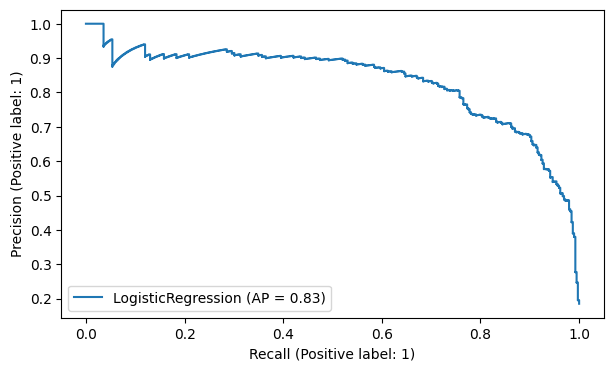

In [43]:
from sklearn.metrics import PrecisionRecallDisplay, average_precision_score

PrecisionRecallDisplay.from_estimator(logistic,
                                      X_test_count,
                                      y_test);

In [44]:
y_pred = logistic.predict(X_test_count)
y_pred_proba= logistic.predict_proba(X_test_count)[:,1]

log_AP_count = average_precision_score(y_test, y_pred_proba)
log_count_rec = recall_score(y_test, y_pred)
log_count_f1 = f1_score(y_test,y_pred)

### TF-IDF

In [45]:
from sklearn.linear_model import LogisticRegression
log = LogisticRegression(C=0.4, max_iter=1000)
log.fit(X_train_tfidf,y_train)

LogisticRegression(C=0.4, max_iter=1000)

In [46]:
eval(log, X_train_tfidf, X_test_tfidf)

[[1699   26]
 [ 150  242]]
Test_Set
              precision    recall  f1-score   support

           0       0.92      0.98      0.95      1725
           1       0.90      0.62      0.73       392

    accuracy                           0.92      2117
   macro avg       0.91      0.80      0.84      2117
weighted avg       0.92      0.92      0.91      2117

Accuracy of test: 0.9168634860651866
AUC of test: 0.8011372375036971
Train_Set
              precision    recall  f1-score   support

           0       0.92      0.99      0.95     15523
           1       0.91      0.64      0.75      3522

    accuracy                           0.92     19045
   macro avg       0.92      0.81      0.85     19045
weighted avg       0.92      0.92      0.92     19045

Accuracy of train: 0.9218167498030979
AUC of train: 0.8130896824967425


In [47]:
scoring= ["accuracy", "f1", "recall", "precision"]
model = LogisticRegression(C=0.4, max_iter=1000)
scores = cross_validate(model, X_train_tfidf, y_train, scoring = scoring, cv = 10, return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_accuracy      0.909583
train_accuracy     0.920166
test_f1            0.703907
train_f1           0.744380
test_recall        0.582345
train_recall       0.628589
test_precision     0.890816
train_precision    0.912488
dtype: float64

In [48]:
pip install scikit-plot

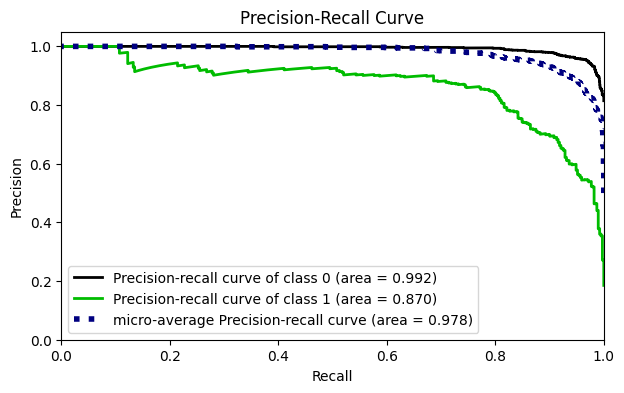

In [49]:
from scikitplot.metrics import plot_roc, plot_precision_recall

model = LogisticRegression(C=0.4, max_iter=1000)

model.fit(X_train_tfidf, y_train)

y_pred_proba = model.predict_proba(X_test_tfidf)

plot_precision_recall(y_test, y_pred_proba)
plt.show();

In [50]:
y_pred = log.predict(X_test_tfidf)
y_pred_proba= log.predict_proba(X_test_tfidf)[:,1]
log_AP_tfidf = average_precision_score(y_test, y_pred_proba)
log_tfidf_rec = recall_score(y_test, y_pred)
log_tfidf_f1 = f1_score(y_test,y_pred)

## Naive Bayes

### Countvectorizer

In [51]:
from sklearn.naive_bayes import MultinomialNB, BernoulliNB
multi_nb = MultinomialNB(alpha=1.5)
multi_nb.fit(X_train_count,y_train)

MultinomialNB(alpha=1.5)

In [52]:
eval(multi_nb, X_train_count, X_test_count)

[[1612  113]
 [  61  331]]
Test_Set
              precision    recall  f1-score   support

           0       0.96      0.93      0.95      1725
           1       0.75      0.84      0.79       392

    accuracy                           0.92      2117
   macro avg       0.85      0.89      0.87      2117
weighted avg       0.92      0.92      0.92      2117

Accuracy of test: 0.9178082191780822
AUC of test: 0.8894402543626145
Train_Set
              precision    recall  f1-score   support

           0       0.97      0.94      0.96     15523
           1       0.78      0.88      0.83      3522

    accuracy                           0.93     19045
   macro avg       0.87      0.91      0.89     19045
weighted avg       0.94      0.93      0.93     19045

Accuracy of train: 0.9311105276975584
AUC of train: 0.9120822455279947


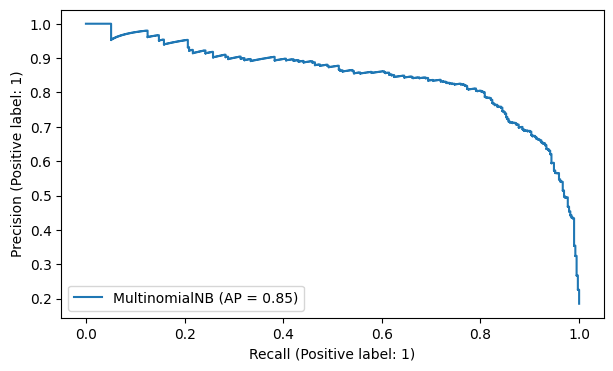

In [53]:
PrecisionRecallDisplay.from_estimator(multi_nb,X_test_count, y_test);

In [54]:
y_pred = multi_nb.predict(X_test_count)
y_pred_proba= multi_nb.predict_proba(X_test_count)[:,1]

nb_AP_count = average_precision_score(y_test, y_pred_proba)
nb_count_rec = recall_score(y_test, y_pred)
nb_count_f1 = f1_score(y_test,y_pred)

### TF-IDF

In [55]:
nb = BernoulliNB(alpha=0.7)
nb.fit(X_train_tfidf,y_train)

BernoulliNB(alpha=0.7)

In [56]:
print("NB TF-IDF MODEL")
eval(nb, X_train_tfidf, X_test_tfidf)

NB TF-IDF MODEL
[[1601  124]
 [  61  331]]
Test_Set
              precision    recall  f1-score   support

           0       0.96      0.93      0.95      1725
           1       0.73      0.84      0.78       392

    accuracy                           0.91      2117
   macro avg       0.85      0.89      0.86      2117
weighted avg       0.92      0.91      0.92      2117

Accuracy of test: 0.9126121870571563
AUC of test: 0.8862518485655131
Train_Set
              precision    recall  f1-score   support

           0       0.97      0.94      0.95     15523
           1       0.76      0.87      0.81      3522

    accuracy                           0.93     19045
   macro avg       0.87      0.90      0.88     19045
weighted avg       0.93      0.93      0.93     19045

Accuracy of train: 0.9261223418220005
AUC of train: 0.9048515980920839


In [57]:
model = BernoulliNB(alpha=0.7)
scores = cross_validate(model,
                        X_train_tfidf,
                        y_train,
                        scoring = scoring,
                        cv = 10,
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_accuracy      0.911473
train_accuracy     0.926717
test_f1            0.775728
train_f1           0.814386
test_recall        0.827941
train_recall       0.869329
test_precision     0.729885
train_precision    0.765979
dtype: float64

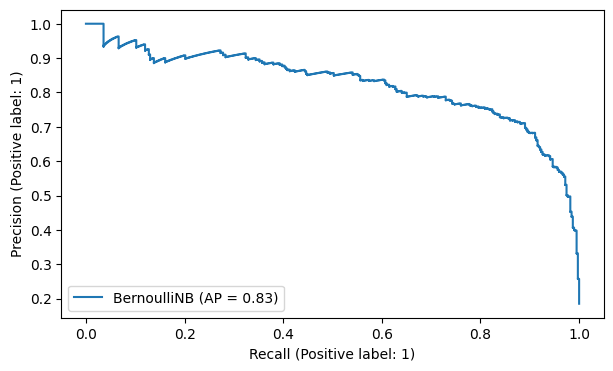

In [58]:
PrecisionRecallDisplay.from_estimator(nb,
                                      X_test_tfidf,
                                      y_test);

In [59]:
y_pred = nb.predict(X_test_tfidf)
y_pred_proba= nb.predict_proba(X_test_tfidf)[:,1]


nb_AP_tfidf = average_precision_score(y_test, y_pred_proba)
nb_tfidf_rec = recall_score(y_test, y_pred)
nb_tfidf_f1 = f1_score(y_test,y_pred)

## Support Vector Machine (SVM)

### Countvectorizer

In [60]:
from sklearn.svm import LinearSVC
lin_svc = LinearSVC(C=0.001,class_weight="balanced",random_state=101)
lin_svc.fit(X_train_count,y_train)

LinearSVC(C=0.001, class_weight='balanced', random_state=101)

In [61]:
eval(lin_svc, X_train_count, X_test_count)

[[1547  178]
 [  39  353]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.90      0.93      1725
           1       0.66      0.90      0.76       392

    accuracy                           0.90      2117
   macro avg       0.82      0.90      0.85      2117
weighted avg       0.92      0.90      0.90      2117

Accuracy of test: 0.8974964572508266
AUC of test: 0.8986608991422655
Train_Set
              precision    recall  f1-score   support

           0       0.98      0.90      0.94     15523
           1       0.67      0.92      0.78      3522

    accuracy                           0.90     19045
   macro avg       0.83      0.91      0.86     19045
weighted avg       0.92      0.90      0.91     19045

Accuracy of train: 0.9029141506957207
AUC of train: 0.9104802282177098


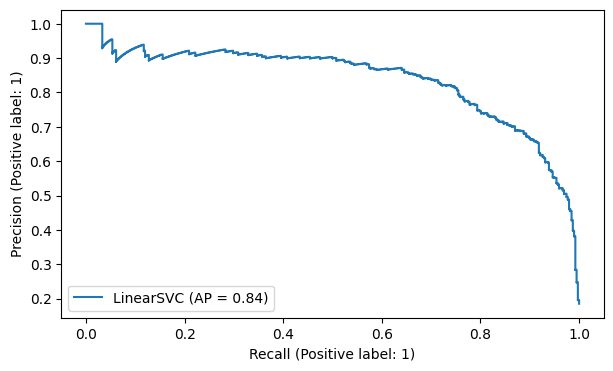

In [62]:
PrecisionRecallDisplay.from_estimator(lin_svc,X_test_count,y_test);

In [63]:
y_pred = lin_svc.predict(X_test_count)
decision_function= lin_svc.decision_function(X_test_count)

svc_AP_count = average_precision_score(y_test, decision_function)
svc_count_rec = recall_score(y_test, y_pred)
svc_count_f1 = f1_score(y_test,y_pred)

# TF-IDF

In [64]:
svc = LinearSVC(C=0.03,
                class_weight="balanced",
                random_state=101)
svc.fit(X_train_tfidf,y_train)

LinearSVC(C=0.03, class_weight='balanced', random_state=101)

In [65]:
print("SVC TF-IDF MODEL")
eval(svc, X_train_tfidf, X_test_tfidf)

SVC TF-IDF MODEL
[[1546  179]
 [  31  361]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.90      0.94      1725
           1       0.67      0.92      0.77       392

    accuracy                           0.90      2117
   macro avg       0.82      0.91      0.86      2117
weighted avg       0.92      0.90      0.91      2117

Accuracy of test: 0.9008030231459613
AUC of test: 0.9085751257024549
Train_Set
              precision    recall  f1-score   support

           0       0.99      0.91      0.95     15523
           1       0.70      0.94      0.80      3522

    accuracy                           0.91     19045
   macro avg       0.84      0.93      0.87     19045
weighted avg       0.93      0.91      0.92     19045

Accuracy of train: 0.9144657390391179
AUC of train: 0.9259078311485407


In [66]:
model = LinearSVC(C=0.03,
                  class_weight="balanced",
                  random_state=101)
scores = cross_validate(model,
                        X_train_tfidf,
                        y_train,
                        scoring = scoring,
                        cv = 10,
                        return_train_score=True)
df_scores = pd.DataFrame(scores,
                         index = range(1, 11))
df_scores.mean()[2:]

test_accuracy      0.901235
train_accuracy     0.913911
test_f1            0.773525
train_f1           0.802289
test_recall        0.911692
train_recall       0.944507
test_precision     0.671801
train_precision    0.697295
dtype: float64

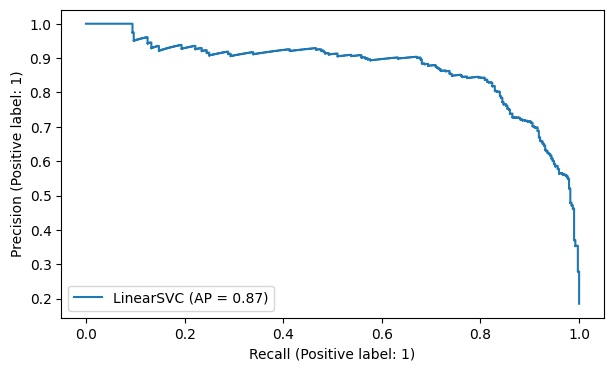

In [67]:
PrecisionRecallDisplay.from_estimator(svc,
                                      X_test_tfidf,
                                      y_test);

In [68]:
y_pred = svc.predict(X_test_tfidf)
decision_function= svc.decision_function(X_test_tfidf)

svc_AP_tfidf = average_precision_score(y_test, decision_function)
svc_tfidf_rec = recall_score(y_test, y_pred)
svc_tfidf_f1 = f1_score(y_test,y_pred)

## Random Forest

### Countvectorizer

In [69]:
from sklearn.ensemble import RandomForestClassifier
randomf = RandomForestClassifier(100,max_depth = 7,random_state = 42,n_jobs = -1,class_weight="balanced")
randomf.fit(X_train_count, y_train)

RandomForestClassifier(class_weight='balanced', max_depth=7, n_jobs=-1,
                       random_state=42)

In [70]:
eval(randomf, X_train_count, X_test_count)

[[1495  230]
 [  51  341]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.87      0.91      1725
           1       0.60      0.87      0.71       392

    accuracy                           0.87      2117
   macro avg       0.78      0.87      0.81      2117
weighted avg       0.90      0.87      0.88      2117

Accuracy of test: 0.8672649976381672
AUC of test: 0.8682823129251702
Train_Set
              precision    recall  f1-score   support

           0       0.97      0.87      0.92     15523
           1       0.61      0.89      0.72      3522

    accuracy                           0.87     19045
   macro avg       0.79      0.88      0.82     19045
weighted avg       0.91      0.87      0.88     19045

Accuracy of train: 0.8733000787608296
AUC of train: 0.8816674478708537


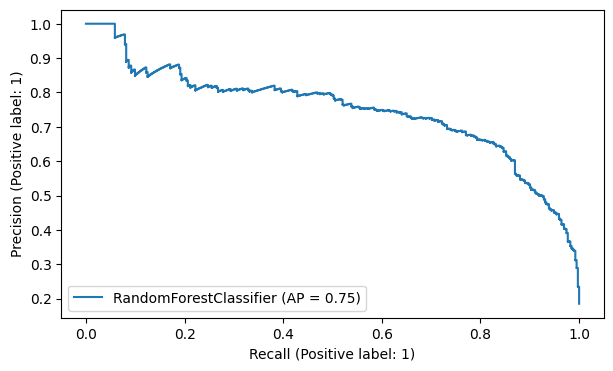

In [71]:
PrecisionRecallDisplay.from_estimator(randomf,X_test_count,y_test);

In [72]:
y_pred = randomf.predict(X_test_count)
y_pred_proba= randomf.predict_proba(X_test_count)[:,1]

rf_AP_count = average_precision_score(y_test, y_pred_proba)
rf_count_rec = recall_score(y_test, y_pred)
rf_count_f1 = f1_score(y_test,y_pred)

### TF-IDF

In [73]:
rf = RandomForestClassifier(100,
                            max_depth = 7,
                            random_state = 42,
                            n_jobs = -1,
                            class_weight="balanced")
rf.fit(X_train_tfidf, y_train)

RandomForestClassifier(class_weight='balanced', max_depth=7, n_jobs=-1,
                       random_state=42)

In [74]:
print("RF MODEL")
eval(rf, X_train_tfidf, X_test_tfidf)

RF MODEL
[[1464  261]
 [  51  341]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.85      0.90      1725
           1       0.57      0.87      0.69       392

    accuracy                           0.85      2117
   macro avg       0.77      0.86      0.79      2117
weighted avg       0.89      0.85      0.86      2117

Accuracy of test: 0.8526216343882853
AUC of test: 0.8592968056787933
Train_Set
              precision    recall  f1-score   support

           0       0.98      0.86      0.91     15523
           1       0.59      0.91      0.71      3522

    accuracy                           0.87     19045
   macro avg       0.78      0.88      0.81     19045
weighted avg       0.90      0.87      0.88     19045

Accuracy of train: 0.8658440535573642
AUC of train: 0.882032543309276


In [75]:
model = RandomForestClassifier(100,
                               max_depth = 7,
                               random_state = 42,
                               n_jobs = -1,
                               class_weight="balanced")
scores = cross_validate(model,
                        X_train_tfidf,
                        y_train,
                        scoring = scoring,
                        cv = 10,
                        return_train_score=True)
df_scores = pd.DataFrame(scores,
                         index = range(1, 11))
df_scores.mean()[2:]

test_accuracy      0.851562
train_accuracy     0.874315
test_f1            0.681638
train_f1           0.727533
test_recall        0.859459
train_recall       0.907123
test_precision     0.564985
train_precision    0.607373
dtype: float64

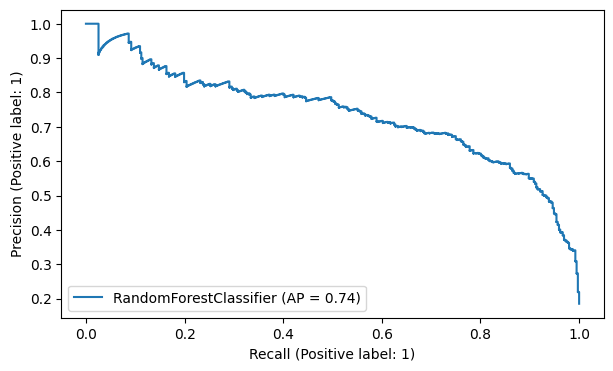

In [76]:
PrecisionRecallDisplay.from_estimator(rf,
                                      X_test_tfidf,
                                      y_test);

In [77]:
y_pred = rf.predict(X_test_tfidf)
y_pred_proba= rf.predict_proba(X_test_tfidf)[:,1]

rf_AP_tfidf = average_precision_score(y_test, y_pred_proba)
rf_tfidf_rec = recall_score(y_test, y_pred)
rf_tfidf_f1 = f1_score(y_test,y_pred)

## Ada Boosting

### Countvectorizer

In [78]:
from sklearn.ensemble import AdaBoostClassifier
ada_Boost = AdaBoostClassifier(n_estimators= 100,random_state = 42)
ada_Boost.fit(X_train_count, y_train)

AdaBoostClassifier(n_estimators=100, random_state=42)

In [79]:
eval(ada_Boost, X_train_count, X_test_count)

[[1651   74]
 [ 154  238]]
Test_Set
              precision    recall  f1-score   support

           0       0.91      0.96      0.94      1725
           1       0.76      0.61      0.68       392

    accuracy                           0.89      2117
   macro avg       0.84      0.78      0.81      2117
weighted avg       0.89      0.89      0.89      2117

Accuracy of test: 0.8923004251299008
AUC of test: 0.7821221532091098
Train_Set
              precision    recall  f1-score   support

           0       0.93      0.96      0.94     15523
           1       0.80      0.66      0.72      3522

    accuracy                           0.91     19045
   macro avg       0.86      0.81      0.83     19045
weighted avg       0.90      0.91      0.90     19045

Accuracy of train: 0.9063271199789971
AUC of train: 0.8106119427920754


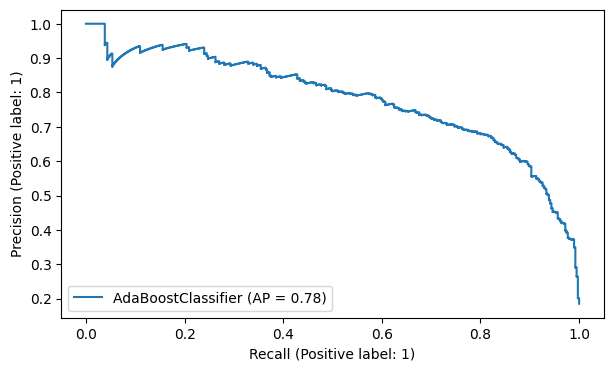

In [80]:
PrecisionRecallDisplay.from_estimator(ada_Boost,X_test_count,y_test);

In [81]:
y_pred = ada_Boost.predict(X_test_count)
y_pred_proba= ada_Boost.predict_proba(X_test_count)[:,1]

ada_AP_count = average_precision_score(y_test, y_pred_proba)
ada_count_rec = recall_score(y_test, y_pred)
ada_count_f1 = f1_score(y_test,y_pred)

### TF-IDF

In [82]:
ada = AdaBoostClassifier(n_estimators= 100,
                         random_state = 42,
                         learning_rate=0.7)
ada.fit(X_train_tfidf, y_train)

AdaBoostClassifier(learning_rate=0.7, n_estimators=100, random_state=42)

In [83]:
print("Ada TF-IDF MODEL")
eval(ada, X_train_tfidf, X_test_tfidf)

Ada TF-IDF MODEL
[[1671   54]
 [ 173  219]]
Test_Set
              precision    recall  f1-score   support

           0       0.91      0.97      0.94      1725
           1       0.80      0.56      0.66       392

    accuracy                           0.89      2117
   macro avg       0.85      0.76      0.80      2117
weighted avg       0.89      0.89      0.88      2117

Accuracy of test: 0.8927727916863486
AUC of test: 0.763684560780834
Train_Set
              precision    recall  f1-score   support

           0       0.92      0.97      0.94     15523
           1       0.83      0.61      0.70      3522

    accuracy                           0.90     19045
   macro avg       0.87      0.79      0.82     19045
weighted avg       0.90      0.90      0.90     19045

Accuracy of train: 0.9046468889472302
AUC of train: 0.7912522086714726


In [84]:
model = AdaBoostClassifier(n_estimators= 100,
                           random_state = 42,
                           learning_rate=0.7)
scores = cross_validate(model,
                        X_train_tfidf,
                        y_train,
                        scoring = scoring,
                        cv = 10,
                        return_train_score=True)
df_scores = pd.DataFrame(scores,
                         index = range(1, 11))
df_scores.mean()[2:]

test_accuracy      0.896772
train_accuracy     0.905090
test_f1            0.676947
train_f1           0.704502
test_recall        0.585460
train_recall       0.611805
test_precision     0.802770
train_precision    0.830319
dtype: float64

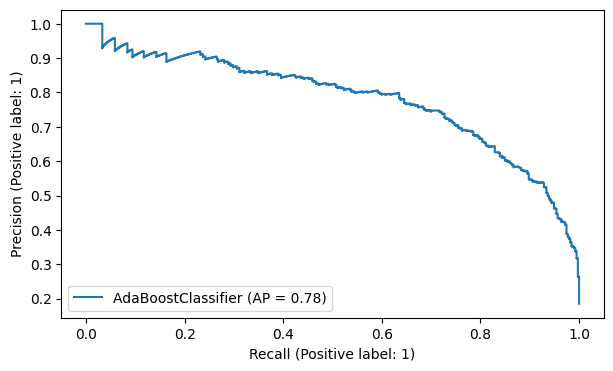

In [85]:
PrecisionRecallDisplay.from_estimator(ada,
                                      X_test_tfidf,
                                      y_test);

In [86]:
y_pred = ada.predict(X_test_tfidf)
y_pred_proba= ada.predict_proba(X_test_tfidf)[:,1]

ada_AP_tfidf = average_precision_score(y_test, y_pred_proba)
ada_tfidf_rec = recall_score(y_test, y_pred)
ada_tfidf_f1 = f1_score(y_test,y_pred)

## DL modeling

In [87]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, GRU, Embedding, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

### Tokenization

In [88]:
num_words = 15001
tokenizer = Tokenizer(num_words=num_words)

In [89]:
tokenizer.fit_on_texts(X)

### Creating word index

In [90]:
tokenizer.word_index

{'dress': 1,
 'love': 2,
 'fit': 3,
 'not': 4,
 'size': 5,
 'top': 6,
 'great': 7,
 'color': 8,
 'like': 9,
 'look': 10,
 'wear': 11,
 'im': 12,
 'fabric': 13,
 'would': 14,
 'small': 15,
 'perfect': 16,
 'cute': 17,
 'beautiful': 18,
 'flattering': 19,
 'really': 20,
 'little': 21,
 'one': 22,
 'soft': 23,
 'ordered': 24,
 'comfortable': 25,
 'nice': 26,
 'well': 27,
 'back': 28,
 'sweater': 29,
 'bought': 30,
 'shirt': 31,
 'run': 32,
 'bit': 33,
 'jean': 34,
 'large': 35,
 'material': 36,
 'much': 37,
 'pretty': 38,
 'length': 39,
 'work': 40,
 'short': 41,
 'long': 42,
 'also': 43,
 'petite': 44,
 'quality': 45,
 'skirt': 46,
 'got': 47,
 'pant': 48,
 'waist': 49,
 'retailer': 50,
 'medium': 51,
 'even': 52,
 'think': 53,
 'make': 54,
 'feel': 55,
 'x': 56,
 'good': 57,
 'store': 58,
 'tried': 59,
 'super': 60,
 'get': 61,
 'usually': 62,
 'way': 63,
 'sleeve': 64,
 'summer': 65,
 'big': 66,
 'go': 67,
 'style': 68,
 'cut': 69,
 'could': 70,
 'made': 71,
 'black': 72,
 'dont': 73,


In [91]:
len(tokenizer.word_index)

12112

### Converting tokens to numeric

In [92]:
X_num_tokens = tokenizer.texts_to_sequences(X)

### Maximum number of tokens for all documents

In [93]:
number_tokens = [len(tokens) for tokens in X_num_tokens]
number_tokens = np.array(number_tokens)

In [94]:
number_tokens.mean()

30.78948114544939

In [95]:
number_tokens.max()

63

In [96]:
max_tokens=63

In [97]:
sum(number_tokens <= max_tokens) / len(number_tokens)

1.0

### Fixing token counts of all documents (pad_sequences)

In [98]:
X_pad = pad_sequences(X_num_tokens, maxlen=max_tokens)
X_pad.shape

(21162, 63)

### Train Set Split

In [99]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_pad, y, test_size=0.1, stratify=y, random_state=101)
X_train.shape, X_test.shape

((19045, 63), (2117, 63))

### Modeling

In [100]:
from keras.models import Sequential
from keras.layers import Dense, Embedding, LSTM, GRU, Flatten, Dropout, Lambda
import tensorflow as tf

In [101]:
model = Sequential()
embedding_size = 50
e = Embedding(input_dim=num_words,
                    output_dim=embedding_size,
                    input_length=max_tokens)
Optimizer = Adam(learning_rate=0.001)
model.add(e)
model.add(tf.keras.layers.Bidirectional(LSTM(256)))
model.add(Dropout(0.50))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer=Optimizer, metrics=["Recall"])

In [102]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 63, 50)            750050    
                                                                 
 bidirectional (Bidirection  (None, 512)               628736    
 al)                                                             
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense (Dense)               (None, 1)                 513       
                                                                 
Total params: 1379299 (5.26 MB)
Trainable params: 1379299 (5.26 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [103]:
from keras.callbacks import ModelCheckpoint, EarlyStopping
Early_stop = EarlyStopping(monitor="val_recall",
                           mode="max",
                           verbose=1,
                           patience = 2,
                           restore_best_weights=True)

In [104]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Thu Nov 16 22:08:10 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P0    26W /  70W |    323MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [105]:
model.fit(X_train, y_train, epochs=32, batch_size=256, verbose=1,
          validation_data=(X_test, y_test), callbacks=[Early_stop])

Epoch 1/32
75/75 [==============================] - 25s 180ms/step - loss: 0.4659 - recall: 0.0281 - val_loss: 0.3264 - val_recall: 0.0485
Epoch 2/32
75/75 [==============================] - 10s 130ms/step - loss: 0.2050 - recall: 0.6999 - val_loss: 0.1830 - val_recall: 0.7449
Epoch 3/32
75/75 [==============================] - 6s 80ms/step - loss: 0.1410 - recall: 0.8504 - val_loss: 0.1792 - val_recall: 0.8316
Epoch 4/32
75/75 [==============================] - 8s 108ms/step - loss: 0.1236 - recall: 0.8836 - val_loss: 0.1858 - val_recall: 0.7985
Epoch 5/32
75/75 [==============================] - 4s 55ms/step - loss: 0.1038 - recall: 0.9029 - val_loss: 0.2141 - val_recall: 0.6888
Epoch 5: early stopping


### Model Evaluation

In [106]:
model_loss = pd.DataFrame(model.history.history)
model_loss

,loss,recall,val_loss,val_recall
0,0.465907,0.028109,0.326384,0.048469
1,0.204973,0.699886,0.182969,0.744898
2,0.141035,0.850369,0.179218,0.831633
3,0.123612,0.883589,0.185768,0.798469
4,0.103839,0.902896,0.214129,0.688776


<Axes: >

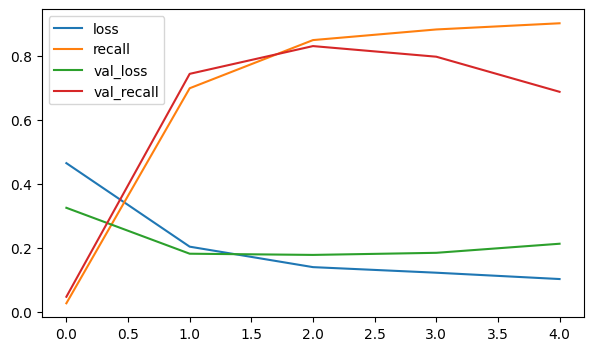

In [107]:
model_loss.plot()

In [108]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, f1_score, roc_auc_score

y_pred = model.predict(X_test) >= 0.5

67/67 [==============================] - 1s 6ms/step


In [109]:
print(confusion_matrix(y_test, y_pred))
print("-------------------------------------------------------")
print(classification_report(y_test, y_pred))

[[1650   75]
 [  66  326]]
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.96      0.96      1725
           1       0.81      0.83      0.82       392

    accuracy                           0.93      2117
   macro avg       0.89      0.89      0.89      2117
weighted avg       0.93      0.93      0.93      2117



In [110]:
y_train_pred = model.predict(X_train) >= 0.5

596/596 [==============================] - 3s 5ms/step


In [111]:
print(confusion_matrix(y_train, y_train_pred))
print("-------------------------------------------------------")
print(classification_report(y_train, y_train_pred))

[[15045   478]
 [  319  3203]]
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.98      0.97      0.97     15523
           1       0.87      0.91      0.89      3522

    accuracy                           0.96     19045
   macro avg       0.92      0.94      0.93     19045
weighted avg       0.96      0.96      0.96     19045



67/67 [==============================] - 0s 4ms/step


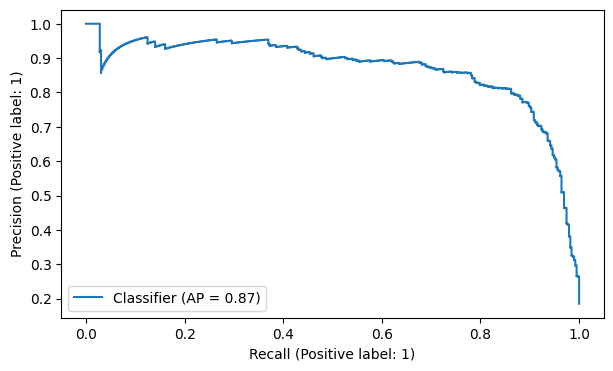

In [112]:
from sklearn.metrics import PrecisionRecallDisplay

y_pred_proba = model.predict(X_test)

PrecisionRecallDisplay.from_predictions(y_test, y_pred_proba)

In [113]:
from sklearn.metrics import average_precision_score

average_precision_score(y_test, y_pred_proba)

0.8701305228699353

In [114]:
DL_AP = average_precision_score(y_test, y_pred_proba)
DL_f1 = f1_score(y_test, y_pred)
DL_rec = recall_score(y_test, y_pred)

## BERT Modeling

In [115]:
!pip install transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 59.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.7/311.7 kB 41.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 121.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 79.0 MB/s eta 0:00:00


### Read Data

In [116]:
X

array(['absolutely wonderful silky sexy comfortable',
       'love dress sooo pretty happened find store im glad bc never would ordered online bc petite bought petite love length hit little knee would definitely true midi someone truly petite',
       'major design flaw high hope dress really wanted work initially ordered petite small usual size found outrageously small small fact could not zip reordered petite medium overall top half comfortable fit nicely bottom half tight layer several somewhat cheap net layer imo major design flaw net layer sewn directly zipper c',
       ...,
       'great dress many occasion happy snag dress great price easy slip flattering cut color combo',
       'cute see fit well top see never would worked im glad able try store didnt order online different fabric would great',
       'please make like one dress lovely platinum feminine fit perfectly easy wear comfy highly recommend'],
      dtype=object)

### Tokenization

In [117]:
#BertTokenizer
from transformers import AutoTokenizer

bert_tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")

(…)cased/resolve/main/tokenizer_config.json:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

(…)rt-base-uncased/resolve/main/config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

(…)bert-base-uncased/resolve/main/vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

(…)base-uncased/resolve/main/tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

In [118]:
bert_tokenizer.vocab

{'flanked': 15874,
 '##nius': 20447,
 'existing': 4493,
 'dee': 9266,
 'investigators': 14766,
 'mentions': 9704,
 '戸': 1857,
 '##dge': 11818,
 'intentional': 21249,
 'bracing': 25919,
 '##nnis': 27803,
 'detailed': 6851,
 '##dee': 26095,
 '##brick': 25646,
 'realizes': 10919,
 'ut': 21183,
 'chaotic': 19633,
 'drop': 4530,
 '##lid': 21273,
 'libraries': 8860,
 'stiff': 10551,
 '[unused200]': 205,
 '##rne': 12119,
 '##tead': 14565,
 'glanced': 3887,
 'saloon': 17078,
 '04': 5840,
 'limbs': 10726,
 'hubert': 15346,
 '##rane': 18053,
 'big': 2502,
 'youngest': 6587,
 '[unused423]': 428,
 'organ': 5812,
 'watkins': 17055,
 'casualty': 19844,
 'clipped': 20144,
 '侍': 1765,
 '##ductive': 26638,
 'siegfried': 25948,
 'overtook': 28920,
 'meaningless': 25120,
 '軍': 1955,
 'chico': 22136,
 '##stand': 21515,
 'coke': 14492,
 'ardent': 25314,
 'refused': 4188,
 'pedestrians': 24946,
 '##under': 20824,
 'mounds': 19503,
 'assassin': 12025,
 'railing': 15747,
 'ang': 17076,
 'miguel': 8374,
 '[unu

In [119]:
print(len(bert_tokenizer.vocab))

30522


### Fixing token counts of all documents

In [120]:
senten_tokens = []
for sent in X:

    encoded_sent = bert_tokenizer.encode(sent,# Preprocess sentence
                                    add_special_tokens=True,
                                         pad_to_max_length=True,
                                         return_attention_mask=True )# Add `[CLS]` and `[SEP]`
    senten_tokens.append(len(encoded_sent)) # Add the outputs to the lists

print('Max sentence length: ', max(senten_tokens))

Max sentence length:  83


In [121]:
np.array(senten_tokens).mean()

35.977317833853135

In [122]:
sum(np.array(senten_tokens) <= 83) / len(senten_tokens)

1.0

In [123]:
all_sent_tokens = bert_tokenizer(list(X),
                                max_length=83,
                                truncation=True,
                                padding='max_length',
                                add_special_tokens=True)

In [124]:
all_sent_tokens

{'input_ids': [[101, 7078, 6919, 18848, 7916, 6625, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [101, 2293, 4377, 17111, 2080, 3492, 3047, 2424, 3573, 10047, 5580, 4647, 2196, 2052, 3641, 3784, 4647, 20146, 4149, 20146, 2293, 3091, 2718, 2210, 6181, 2052, 5791, 2995, 22265, 2619, 5621, 20146, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [101, 2350, 2640, 28450, 2152, 3246, 4377, 2428, 2359, 2147, 3322, 3641, 20146, 2235, 5156, 2946, 2179, 25506, 2135, 2235, 2235, 2755, 2071, 2025, 14101, 2128, 8551, 6850, 20146, 5396, 3452, 2327, 2431, 6625, 4906, 19957, 3953, 2431, 4389, 6741, 2195, 5399, 10036, 5658, 6741, 10047, 2080, 2350, 2640, 28450, 5658, 6741, 7367, 7962, 3495, 22082, 1039, 102, 0, 

### Transformation Vectors to Matrices

In [125]:
def transformation(X):
  # set array dimensions
  seq_len = 83

  all_sentence_tokens = bert_tokenizer(list(X),
                                  max_length=seq_len,
                                  truncation=True,
                                  padding='max_length',
                                  add_special_tokens=True)

  return np.array(all_sentence_tokens['input_ids']), np.array(all_sentence_tokens['attention_mask'])

##Train Test Split

In [126]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X,y,test_size=0.1,stratify=y,random_state=101)

In [127]:
Xids_train, Xmask_train = transformation(X_train2)

Xids_test, Xmask_test = transformation(X_test2)

In [128]:
print("Xids_train.shape  :", Xids_train.shape)
print("Xmask_train.shape :", Xmask_train.shape)
print("Xids_test.shape   :", Xids_test.shape)
print("Xmask_test.shape  :", Xmask_test.shape)

Xids_train.shape  : (19045, 83)
Xmask_train.shape : (19045, 83)
Xids_test.shape   : (2117, 83)
Xmask_test.shape  : (2117, 83)


In [129]:
labels_train = y_train2.reshape(-1,1)
labels_train

array([[1],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]])

In [130]:
labels_test = y_test2.reshape(-1,1)
labels_test

array([[1],
       [0],
       [1],
       ...,
       [0],
       [0],
       [0]])

### Transformation Matrix to Tensorflow tensor

In [131]:
import tensorflow as tf

In [132]:
train_dataset = tf.data.Dataset.from_tensor_slices((Xids_train,Xmask_train,labels_train))
train_dataset

<_TensorSliceDataset element_spec=(TensorSpec(shape=(83,), dtype=tf.int64, name=None), TensorSpec(shape=(83,), dtype=tf.int64, name=None), TensorSpec(shape=(1,), dtype=tf.int64, name=None))>

In [133]:
test_dataset = tf.data.Dataset.from_tensor_slices((Xids_test,Xmask_test,labels_test))
test_dataset

<_TensorSliceDataset element_spec=(TensorSpec(shape=(83,), dtype=tf.int64, name=None), TensorSpec(shape=(83,), dtype=tf.int64, name=None), TensorSpec(shape=(1,), dtype=tf.int64, name=None))>

In [134]:
def map_func(Tensor_Xids, Tensor_Xmask, Tensor_labels):
    return {'input_ids': Tensor_Xids, 'attention_mask': Tensor_Xmask}, Tensor_labels

In [135]:
#map method to apply transformation
train_dataset = train_dataset.map(map_func)

In [136]:
train_dataset

<_MapDataset element_spec=({'input_ids': TensorSpec(shape=(83,), dtype=tf.int64, name=None), 'attention_mask': TensorSpec(shape=(83,), dtype=tf.int64, name=None)}, TensorSpec(shape=(1,), dtype=tf.int64, name=None))>

In [137]:
test_dataset = test_dataset.map(map_func)

In [138]:
test_dataset

<_MapDataset element_spec=({'input_ids': TensorSpec(shape=(83,), dtype=tf.int64, name=None), 'attention_mask': TensorSpec(shape=(83,), dtype=tf.int64, name=None)}, TensorSpec(shape=(1,), dtype=tf.int64, name=None))>

### Batch Size

In [139]:
batch_size = 16

# The developers who developed the BERT model recommend using batch sizes of 16 and 32.

train_ds = train_dataset.batch(batch_size)
val_ds = test_dataset.batch(batch_size)

In [140]:
train_ds

<_BatchDataset element_spec=({'input_ids': TensorSpec(shape=(None, 83), dtype=tf.int64, name=None), 'attention_mask': TensorSpec(shape=(None, 83), dtype=tf.int64, name=None)}, TensorSpec(shape=(None, 1), dtype=tf.int64, name=None))>

In [141]:
!pip install -q tf-models-official

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 13.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.7/119.7 kB 13.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 48.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 5.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 241.2/241.2 kB 19.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 69.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 475.2/475.2 MB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 71.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 442.0/442.0 kB 28.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 61.6 MB/s eta 0:00:00


### Creating optimization

In [142]:
from official.nlp import optimization
epochs = 3
steps_per_epoch = len(train_ds)

num_train_steps = steps_per_epoch * epochs
num_warmup_steps = int(0.1*num_train_steps)

init_lr = 2e-5  # 3e-5, 5e-5
optimizer= optimization.create_optimizer(init_lr=init_lr,
                                          num_train_steps=num_train_steps,
                                          num_warmup_steps=num_warmup_steps,
                                          optimizer_type='adamw')

### Creating Model with TPU

In [143]:
# Detect hardware
try:
  tpu = tf.distribute.cluster_resolver.TPUClusterResolver() # TPU detection
except ValueError: # If TPU not found
  tpu = None

In [144]:

# Select appropriate distribution strategy
if tpu:
  tf.tpu.experimental.initialize_tpu_system(tpu)
  strategy = tf.distribute.experimental.TPUStrategy(tpu, steps_per_run=128)
  print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
else:
  strategy = tf.distribute.get_strategy() # Default strategy that works on CPU and single GPU
  print('Running on CPU instead')
print("Number of accelerators: ", strategy.num_replicas_in_sync)

Running on CPU instead
Number of accelerators:  1


In [145]:
def create_model():
    from transformers import TFAutoModel
    from tensorflow.keras.layers import Input, Dropout, Dense, BatchNormalization
    from tensorflow.keras import Model

    model = TFAutoModel.from_pretrained("bert-base-uncased")

    input_ids = Input(shape=(83,), name='input_ids', dtype='int32')
    attention_mask = Input(shape=(83,), name='attention_mask', dtype='int32')

    embeddings = model.bert(input_ids=input_ids, attention_mask=attention_mask)["pooler_output"]

    x = Dense(80, activation='relu')(embeddings)
    x = BatchNormalization()(x)
    x = Dropout(0.1, name="dropout")(x)
    y = Dense(1, activation='sigmoid', name='outputs')(x)

    return Model(inputs=[input_ids, attention_mask], outputs=y)

In [146]:
with strategy.scope():
  loss = tf.keras.losses.BinaryCrossentropy()
  recall =tf. keras.metrics.Recall()
  model_bert = create_model()
  model_bert.compile(optimizer=optimizer, loss=loss, metrics=[recall])

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions w

In [147]:
model_bert.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_ids (InputLayer)      [(None, 83)]                 0         []                            
                                                                                                  
 attention_mask (InputLayer  [(None, 83)]                 0         []                            
 )                                                                                                
                                                                                                  
 bert (TFBertMainLayer)      TFBaseModelOutputWithPooli   1094822   ['input_ids[0][0]',           
                             ngAndCrossAttentions(last_   40         'attention_mask[0][0]']      
                             hidden_state=(None, 83, 76                                       

In [148]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 13.6 gigabytes of available RAM

Not using a high-RAM runtime


### Model Fiting

In [149]:
%time
model_bert.fit(train_ds, validation_data= val_ds, epochs=epochs)

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 6.91 µs
Epoch 1/3
1191/1191 [==============================] - 438s 333ms/step - loss: 0.4756 - recall: 0.8061 - val_loss: 0.3439 - val_recall: 0.7526
Epoch 2/3
1191/1191 [==============================] - 390s 328ms/step - loss: 0.2914 - recall: 0.8668 - val_loss: 0.3760 - val_recall: 0.8342
Epoch 3/3
1191/1191 [==============================] - 397s 333ms/step - loss: 0.1880 - recall: 0.9145 - val_loss: 0.3924 - val_recall: 0.8571


### Model evaluation

In [150]:
model_loss = pd.DataFrame(model_bert.history.history)
model_loss.head()

,loss,recall,val_loss,val_recall
0,0.475600,0.806076,0.343872,0.752551
1,0.291376,0.866837,0.375992,0.834184
2,0.187986,0.914537,0.392418,0.857143


<Axes: >

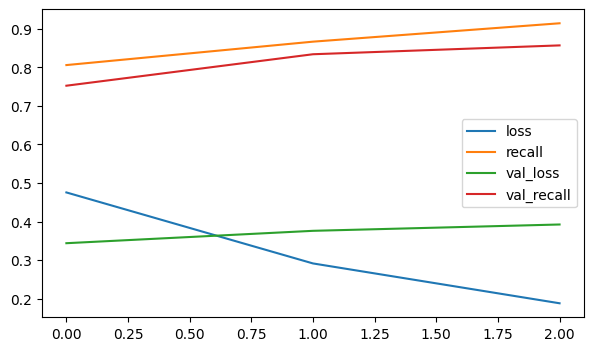

In [151]:
model_loss.plot()

In [152]:
from sklearn.metrics import classification_report, confusion_matrix

y_pred = model_bert.predict(val_ds) >= 0.5

print(classification_report(y_test2, y_pred))

133/133 [==============================] - 17s 105ms/step
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      1725
           1       0.86      0.86      0.86       392

    accuracy                           0.95      2117
   macro avg       0.92      0.91      0.91      2117
weighted avg       0.95      0.95      0.95      2117



In [153]:
y_train_pred = model_bert.predict(train_ds) >= 0.5

print(classification_report(y_train2, y_train_pred))

1191/1191 [==============================] - 134s 113ms/step
              precision    recall  f1-score   support

           0       0.99      0.99      0.99     15523
           1       0.97      0.94      0.96      3522

    accuracy                           0.98     19045
   macro avg       0.98      0.97      0.97     19045
weighted avg       0.98      0.98      0.98     19045



133/133 [==============================] - 14s 103ms/step


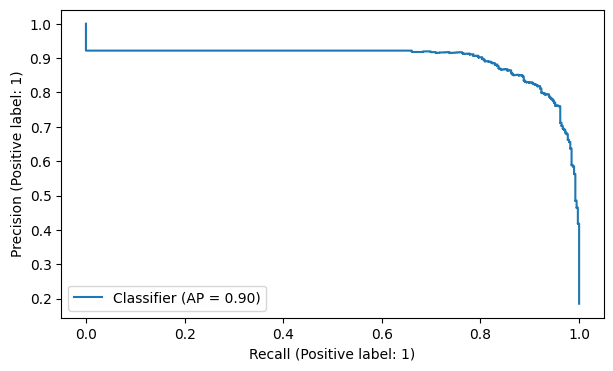

In [154]:
y_pred_proba = model_bert.predict(val_ds)

PrecisionRecallDisplay.from_predictions(y_test, y_pred_proba)

In [155]:
average_precision_score(y_test2, y_pred_proba)

0.8958552774836961

In [156]:
BERT_without_weighted_AP = average_precision_score(y_test2, y_pred_proba)
BERT_without_weighted_f1 = f1_score(y_test2, y_pred)
BERT_without_weighted_rec = recall_score(y_test2, y_pred)

## BERT Model (Weighted)

In [157]:
def create_model():
    from transformers import TFAutoModel
    from tensorflow.keras.layers import Input, Dropout, Dense, BatchNormalization
    from tensorflow.keras import Model

    model = TFAutoModel.from_pretrained("bert-base-uncased")

    input_ids = Input(shape=(83,), name='input_ids', dtype='int32')
    attention_mask = Input(shape=(83,), name='attention_mask', dtype='int32')

    embeddings = model.bert(input_ids=input_ids, attention_mask=attention_mask)["pooler_output"] #[1]

    x = Dense(80, activation='relu')(embeddings)
    x = BatchNormalization()(x)
    x = Dropout(0.1, name="dropout")(x) #0.1
    y = Dense(1, activation='sigmoid', name='outputs')(x)

    return Model(inputs=[input_ids, attention_mask], outputs=y)

In [158]:
from official.nlp import optimization
epochs = 3
steps_per_epoch = len(train_ds)

num_train_steps = steps_per_epoch * epochs
num_warmup_steps = int(0.1*num_train_steps)

init_lr = 2e-5  # 3e-5, 5e-5
optimizer= optimization.create_optimizer(init_lr=init_lr,
                                         num_train_steps=num_train_steps,num_warmup_steps=num_warmup_steps,
                                          optimizer_type='adamw')

In [159]:
with strategy.scope():

  from tensorflow.keras.optimizers import Adam
  from tensorflow.keras.losses import BinaryCrossentropy
  from tensorflow.keras.metrics import Recall

  optimizer = optimizer
  loss = BinaryCrossentropy()
  precision = Recall()
  model_bert_w = create_model()
  model_bert_w.compile(optimizer=optimizer, loss=loss, metrics=[recall])

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions w

In [160]:
model_bert_w.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_ids (InputLayer)      [(None, 83)]                 0         []                            
                                                                                                  
 attention_mask (InputLayer  [(None, 83)]                 0         []                            
 )                                                                                                
                                                                                                  
 bert (TFBertMainLayer)      TFBaseModelOutputWithPooli   1094822   ['input_ids[0][0]',           
                             ngAndCrossAttentions(last_   40         'attention_mask[0][0]']      
                             hidden_state=(None, 83, 76                                     

In [161]:
pd.Series(y).value_counts(normalize=True)

0    0.815046
1    0.184954
dtype: float64

In [164]:
weights = {0:0.18, 1:0.81}

In [165]:
model_bert_w.fit(train_ds, validation_data= val_ds,epochs=epochs, class_weight=weights)

Epoch 1/3
1191/1191 [==============================] - 399s 334ms/step - loss: 0.1156 - recall: 0.8680 - val_loss: 0.2184 - val_recall: 0.8393
Epoch 2/3
1191/1191 [==============================] - 398s 334ms/step - loss: 0.0694 - recall: 0.9114 - val_loss: 0.3177 - val_recall: 0.9107
Epoch 3/3
1191/1191 [==============================] - 398s 335ms/step - loss: 0.0458 - recall: 0.9432 - val_loss: 0.3090 - val_recall: 0.8699


##Model evaluation

In [167]:
y_pred = model_bert_w.predict(val_ds) >= 0.5


print(classification_report(y_test2, y_pred))

133/133 [==============================] - 14s 105ms/step
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      1725
           1       0.87      0.87      0.87       392

    accuracy                           0.95      2117
   macro avg       0.92      0.92      0.92      2117
weighted avg       0.95      0.95      0.95      2117



In [168]:
y_train_pred = model_bert_w.predict(train_ds) >= 0.5


print(classification_report(y_train2, y_train_pred))

1191/1191 [==============================] - 126s 106ms/step
              precision    recall  f1-score   support

           0       0.99      0.99      0.99     15523
           1       0.96      0.97      0.96      3522

    accuracy                           0.99     19045
   macro avg       0.98      0.98      0.98     19045
weighted avg       0.99      0.99      0.99     19045



In [169]:
y_pred_proba = model_bert_w.predict(val_ds)
average_precision_score(y_test2, y_pred_proba)

133/133 [==============================] - 14s 105ms/step


0.9079728370378458

In [170]:
BERT_with_weighted_AP = average_precision_score(y_test2, y_pred_proba)
BERT_with_weighted_f1 = f1_score(y_test2, y_pred)
BERT_with_weighted_rec = recall_score(y_test2, y_pred)

### Compare Models F1 Scores, Recall Scores and Average Precision Score

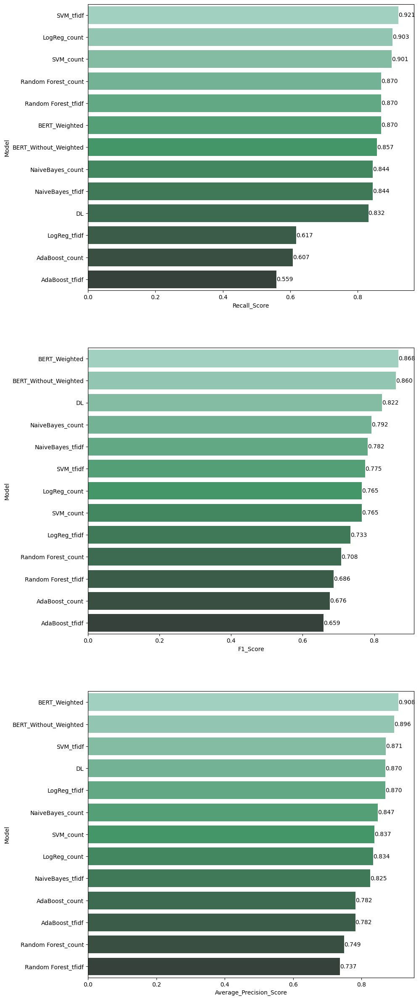

In [171]:
compare_models = pd.DataFrame({"Model": ["NaiveBayes_count", "LogReg_count", "SVM_count", "Random Forest_count",
                                  "AdaBoost_count", "NaiveBayes_tfidf", "LogReg_tfidf", "SVM_tfidf",
                                  "Random Forest_tfidf", "AdaBoost_tfidf", "DL", "BERT_Weighted", "BERT_Without_Weighted"],

                        "F1_Score": [nb_count_f1, log_count_f1, svc_count_f1, rf_count_f1, ada_count_f1, nb_tfidf_f1,
                                     log_tfidf_f1, svc_tfidf_f1, rf_tfidf_f1, ada_tfidf_f1, DL_f1, BERT_with_weighted_f1,
                                     BERT_without_weighted_f1],

                        "Recall_Score": [nb_count_rec, log_count_rec, svc_count_rec, rf_count_rec, ada_count_rec, nb_tfidf_rec,
                                         log_tfidf_rec, svc_tfidf_rec, rf_tfidf_rec, ada_tfidf_rec, DL_rec, BERT_with_weighted_rec,
                                         BERT_without_weighted_rec],

                        "Average_Precision_Score": [nb_AP_count, log_AP_count, svc_AP_count, rf_AP_count, ada_AP_count, nb_AP_tfidf,
                                                    log_AP_tfidf, svc_AP_tfidf, rf_AP_tfidf, ada_AP_tfidf, DL_AP, BERT_with_weighted_AP,
                                                    BERT_without_weighted_AP]})


plt.figure(figsize=(10,30))
plt.subplot(311)
compare_models = compare_models.sort_values(by="Recall_Score",
                              ascending=False)
ax=sns.barplot(x="Recall_Score",
               y="Model",
               data=compare_models,
               palette="BuGn_d")
ax.bar_label(ax.containers[0], fmt="%.3f")

plt.subplot(312)
compare_models = compare_models.sort_values(by="F1_Score",
                              ascending=False)
ax=sns.barplot(x="F1_Score",
               y="Model",
               data=compare_models,
               palette="BuGn_d")
ax.bar_label(ax.containers[0], fmt="%.3f")


plt.subplot(313)
compare_models = compare_models.sort_values(by="Average_Precision_Score",
                              ascending=False)
ax=sns.barplot(x="Average_Precision_Score",
               y="Model",
               data=compare_models,
               palette="BuGn_d")
ax.bar_label(ax.containers[0], fmt="%.3f")
plt.show();

### Conclusion

___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___